> Exploring a range of guidance values for T-Normalization.  

# Introduction

This notebook is Part 5 in a [series](https://enzokro.dev/blog/posts/2022-11-15-guidance-expts-5) on dynamic Classifier-free Guidance. It explores smaller $G$ values for normalizations.  

## Recap of Parts 1-4  

The first three parts explored how to turn Classifier-free Guidance into a dynamic process. We found an initial set of schedules and normalizers that seem to improve the quality of Diffusion images. We then dug in and refined a few of the most promising schedules.

## Part 5: Exploring values for `T-Normalization`

Part 5 answers the question: what should the value of $G_\text{small}$ be for `T-Normalization` and `Full Normalization`?    

Recall that these two normalizations scale the update vector $\left(t - u \right)$. That places the update vector on a different scale than the unconditioned vector $u$. If we then scaled the update vector by a large scalar, say $G = 7.5$, the output collapses to noise. In fact it seems to collapse to the true mode of the latent image distribution: uniform, brown values.  

These two normalizations are very promising: they improve the syntax and details of the image. However, we only explored a single value of $G_\text{small} = 0.15$. This is very different from the default $G = 7.5$ that has been truly explored in regular Classifier-free Guidance.  

This notebook tries to find a good starting point for $G_\text{small}$, so we can try the normalizations with our best schedules so far.

# Python imports

We start with a few basic python imports.

In [ ]:
import os
import random
from functools import partial
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

## Seed for reproducibility

`seed_everything` makes sure that the results are reproducible across notebooks.

In [ ]:
# set the seed and pseudo random number generator
SEED = 1024
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    generator = torch.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    return generator

# for sampling the initial, noisy latents
generator = seed_everything(SEED)

# Constant schedules with a range of $G_\text{small}$ values

We can try different $G_\text{small}$ values using the `cf_guidance` library.

In [ ]:
# helpers to create cosine schedules
from cf_guidance.schedules  import get_cos_sched

# normalizations for classifier-free guidance
from cf_guidance.transforms import TNormGuidance, FullNormGuidance

For the other schedule parameters, we will use the [same values](https://enzokro.dev/blog/posts/2022-11-20-guidance-expts-2/#default-schedule-parameters) from the running series on dynamic Classifier-free Guidance.  

In [ ]:
# Default schedule parameters from the blog post
######################################
max_val           = 0.15  # guidance scaling value
min_val           = 0.0   # minimum guidance scaling
num_steps         = 50    # number of diffusion steps
num_warmup_steps  = 0     # number of warmup steps
warmup_init_val   = 0     # the intial warmup value
num_cycles        = 0.5   # number of cosine cycles
k_decay           = 1     # k-decay for cosine curve scaling 
######################################

DEFAULT_COS_PARAMS = {
    'max_val':           max_val,
    'num_steps':         num_steps,
    'min_val':           min_val,
    'num_cycles':        num_cycles,
    'k_decay':           k_decay,
    'num_warmup_steps':  num_warmup_steps,
    'warmup_init_val':   warmup_init_val,
}

def cos_harness(new_params={}, default_params={}):
    '''Creates cosine schedules with updated parameters in `new_params`
    '''
    # start from the given baseline `cos_params`
    cos_params = dict(default_params)
    # update the schedule with any new parameters
    cos_params.update(new_params)
    
    # return the new cosine schedule
    sched = get_cos_sched(**cos_params)
    return sched


def create_expts(params: dict, schedule_func) -> list:
    '''Creates a list of experiments.
    
    Each element is a dictionary with the name, value, and schedule for a given parameter.
    A `title` field is also added for easy plotting.
    '''
    names = sorted(params)
    expts = []
    # step through parameter names and their values
    for i,name in enumerate(names):
        for j,val in enumerate(params[name]):
            # create the experiment
            expt = {'param_name': name,
                    'val': val,
                    'schedule': schedule_func(val)}
                    # 'schedule': schedule_func({name: val})}
            # name for plotting
            expt['title'] = f'Param: "{name}", val={val}'
            # add it to the experiment list
            expts.append(expt)
    return expts


# create the constant G_small cosine experiments
const_params = {'max_val': [0.01, 0.03, 0.05, 0.08, 0.1, 0.15, 0.2, 0.22, 0.25, 0.3]}
const_func = lambda val: [val for _ in range(num_steps)]
const_expts = create_expts(const_params, const_func)

# Plotting the $G_\text{small}$ values

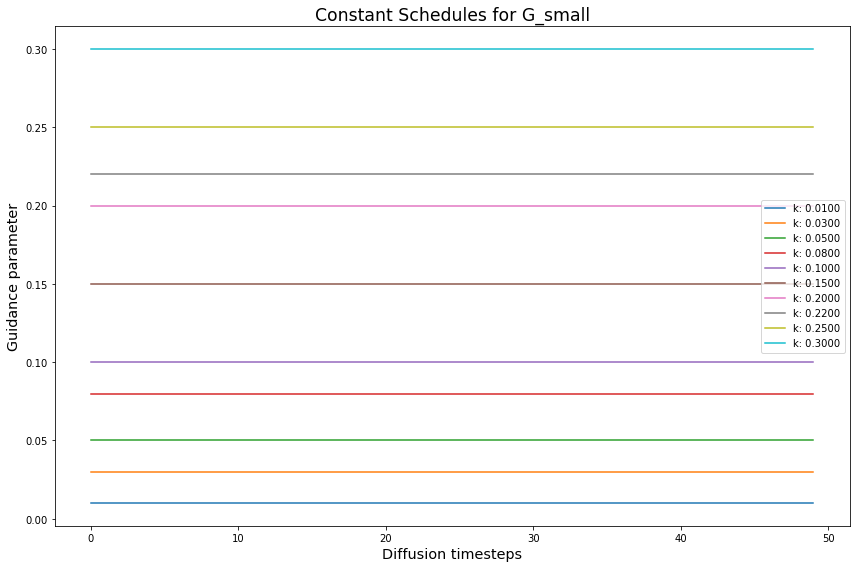

In [ ]:
#| echo: false
#| output: true
colors=list(mcolors.TABLEAU_COLORS)

# setup the plot
fig,ax = plt.subplots(figsize=(12,8))
plt.title('Constant Schedules for G_small', fontsize='xx-large')
plt.xlabel('Diffusion timesteps', fontsize='x-large')
plt.ylabel('Guidance parameter', fontsize='x-large')

# plot each k values
for idx,s in enumerate(const_expts):
    ax.plot(s['schedule'], c=colors[idx], label=f'k: {s["val"]:.4f}')
    
plt.legend()
plt.tight_layout();

# Loading the `openjourney` model from Prompt Hero

The `min_diffusion` library loads a Stable Diffusion model from the HuggingFace hub.

In [ ]:
# to load Stable Diffusion pipelines
from min_diffusion.core import MinimalDiffusion

# to plot generated images
from min_diffusion.utils import show_image, image_grid, plot_grid

2022-11-24 20:59:11.535760: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


We use it to load the `openjourney` model on the GPU in `torch.float16` precision.

In [ ]:
model_name = 'prompthero/openjourney'
device     = 'cuda'
dtype      = torch.float16

In [ ]:
pipeline = MinimalDiffusion(model_name, device, dtype, generator=generator)

In [ ]:
pipeline.load();

Enabling default unet attention slicing.


# Text prompt for image generations

We use the familiar, running prompt in our series to generate an image:  

> "a photograph of an astronaut riding a horse"

:::: {.callout-important}  
The `openjourney` model was fine-tuned to create images in the style of [Midjourney v4](https://mezha.media/en/2022/11/11/midjourney-v4-is-an-incredible-new-version-of-the-ai-image-generator/).  

To enable this fine-tuned style, we need to add the keyword `"mdjrny-v4"` at the start of the prompt.  
::::

In [ ]:
# text prompt for image generations
prompt = "mdjrny-v4 style a photograph of an astronaut riding a horse"

## Image parameters

Images will be generated over $50$ diffusion steps. They will have a height and width of `512 x 512` pixels. 

In [ ]:
# the number of diffusion steps
num_steps = 50

# generated image dimensions
width, height = 512, 512

# Running the experiments

The `run` function below generates images for the given `prompt`.  

It also stores the output images with a matching title for plotting and visualizations.

In [ ]:
def run(prompt, schedules, guide_tfm=None, generator=None,
        show_each=False, test_run=False):
    """Runs a dynamic Classifier-free Guidance experiment. 
    
    Generates an image for the text `prompt` given all the values in `schedules`.
    Uses a Guidance Transformation class from the `cf_guidance` library.  
    Stores the output images with a matching title for plotting. 
    Optionally shows each image as its generated.
    If `test_run` is true, it runs a single schedule for testing. 
    """
    # store generated images and their title (the experiment name)
    images, titles = [], []
    
    # make sure we have a valid guidance transform
    assert guide_tfm
    print(f'Using Guidance Transform: {guide_tfm}')
    
    # optionally run a single test schedule
    if test_run:
        print(f'Running a single schedule for testing.')
        schedules = schedules[:1]
        
    # run all schedule experiments
    for i,s in enumerate(schedules):
        
        # parse out the title for the current run
        cur_title  = s['title']
        titles.append(cur_title)
        
        # create the guidance transformation 
        cur_sched = s['schedule']
        gtfm = guide_tfm({'g': cur_sched})
        
        print(f'Running experiment [{i+1} of {len(schedules)}]: {cur_title}...')
        img = pipeline.generate(prompt, gtfm, generator=generator)
        images.append(img)
        
        # optionally plot the image
        if show_each:
            show_image(img, scale=1)

    print('Done.')
    return {'images': images,
            'titles': titles}

# Sweeping the $G_\text{small}$ values

Now we generate images for the range of constant $G_\text{small}$ values. Then we will check the outputs to see what a good, default value might be.

## `T-Normalization` with $G_\text{small}$ sweep

In [ ]:
print('Running the k-Sweep experiments...')
t_norm_res = run(prompt, const_expts, guide_tfm=TNormGuidance)

Running the k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 10]: Param: "max_val", val=0.01...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 10]: Param: "max_val", val=0.03...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 10]: Param: "max_val", val=0.05...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 10]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 10]: Param: "max_val", val=0.1...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 10]: Param: "max_val", val=0.15...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 10]: Param: "max_val", val=0.2...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 10]: Param: "max_val", val=0.22...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 10]: Param: "max_val", val=0.25...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 10]: Param: "max_val", val=0.3...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


## `Full Normalization` with $G_\text{small}$ sweep

In [ ]:
print('Running the k-Sweep experiments...')
full_norm_res = run(prompt, const_expts, guide_tfm=FullNormGuidance)

Running the k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.FullNormGuidance'>
Running experiment [1 of 10]: Param: "max_val", val=0.01...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 10]: Param: "max_val", val=0.03...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 10]: Param: "max_val", val=0.05...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 10]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 10]: Param: "max_val", val=0.1...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 10]: Param: "max_val", val=0.15...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 10]: Param: "max_val", val=0.2...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 10]: Param: "max_val", val=0.22...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 10]: Param: "max_val", val=0.25...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 10]: Param: "max_val", val=0.3...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


# Results

## `T-Normalization` $G_\text{small}$ results

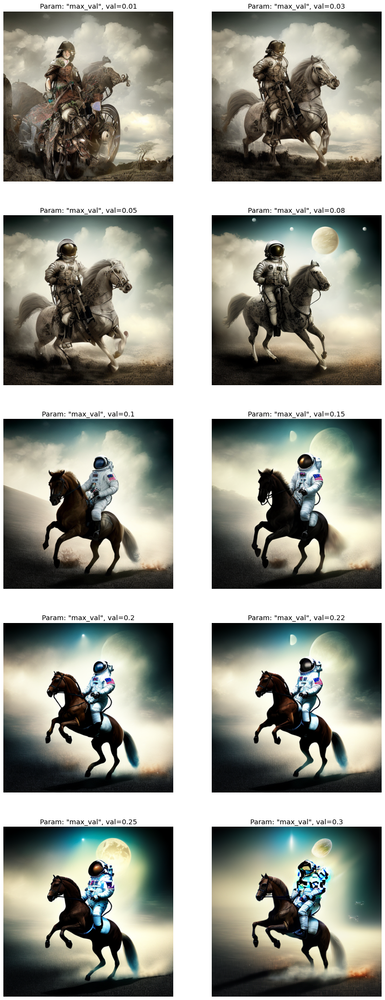

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(t_norm_res['images'], title=t_norm_res['titles'], rows=5, width=width, height=height)

## `Full Normalization` $G_\text{small}$ results

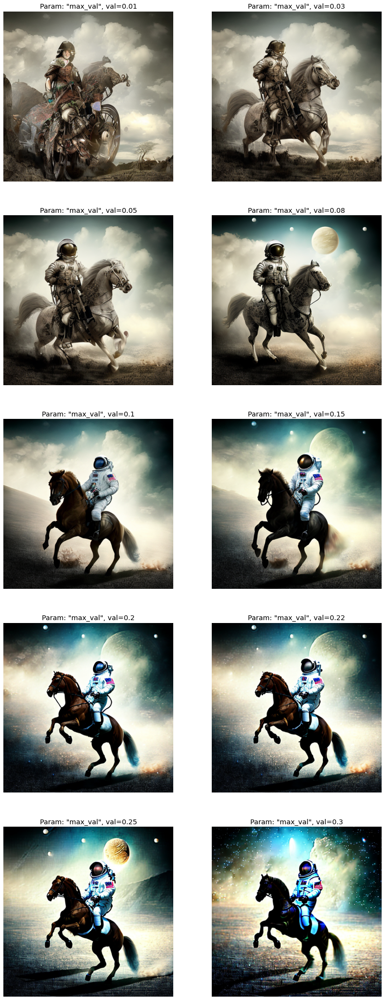

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(full_norm_res['images'], title=full_norm_res['titles'], rows=5, width=width, height=height)

# Analysis

The sweet spot for $G_\text{small}$ seems to be between 0.08 and 0.2. But, there are some massive changes between the values. Much more than was expected. 

It seems that values below 0.08 are too small. The images never form or are too abstract. Likewise, values above 0.2 start to smear the image with weird colors. Both of these results could be ok for artistic generations, but in this case we are trying to improve the realism and quality of the images.    

## Phase change in the image  

Most interesting, there is a "phase change" between the values of 0.08 and 0.1. The image completely changes style and pose from the previous results we've seen so far in the series. This phase change on its own deserves more exploration! What happens around these values of $G_\text{small}$?  

Let's re-run experiments focused on this range. We will pick 10 points uniformly spread between 0.08 and 0.1 to see if we can catch where the phase changes.   

# Re-runs to find the phase change

In [ ]:
low_bound = 0.08
hi_bound = 0.102
npoints = 11

points = np.linspace(low_bound, hi_bound, npoints+1); points

array([0.08 , 0.082, 0.084, 0.086, 0.088, 0.09 , 0.092, 0.094, 0.096,
       0.098, 0.1  , 0.102])

In [ ]:
# create the constant G_small cosine experiments
phase_params = {'max_val': list(points)}
phase_func = lambda val: [val for _ in range(num_steps)]
phase_expts = create_expts(phase_params, phase_func)

In [ ]:
print('Running the phase change k-Sweep experiments...')
phase_res = run(prompt, phase_expts, guide_tfm=TNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.082...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.084...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.086...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.088...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.09...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.092...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.094...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.096...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.09799999999999999...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.09999999999999999...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.102...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


## `T-Normalization` with $G_\text{small}$ phase change

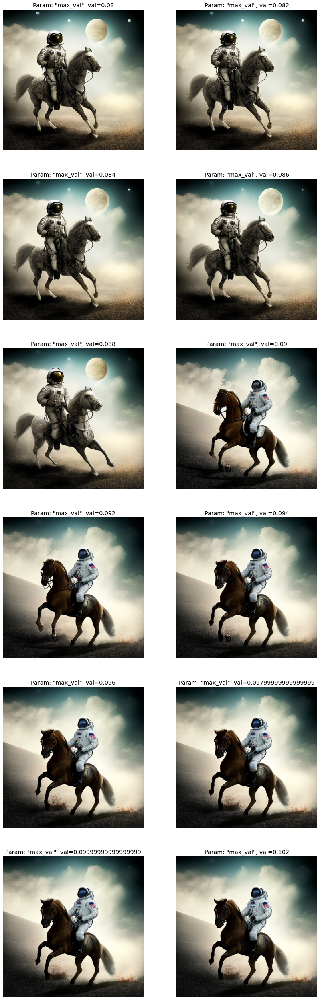

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(phase_res['images'], title=phase_res['titles'], rows=6, width=width, height=height)

It seems the phase change happens between 0.088 and 0.09. Let's check if this is also true for `Full Normalization`. 

## `Full Normalization` with $G_\text{small}$ phase change

In [ ]:
print('Running the phase change k-Sweep experiments...')
full_phase_res = run(prompt, phase_expts, guide_tfm=FullNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.FullNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.082...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.084...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.086...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.088...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.09...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.092...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.094...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.096...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.09799999999999999...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.09999999999999999...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.102...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


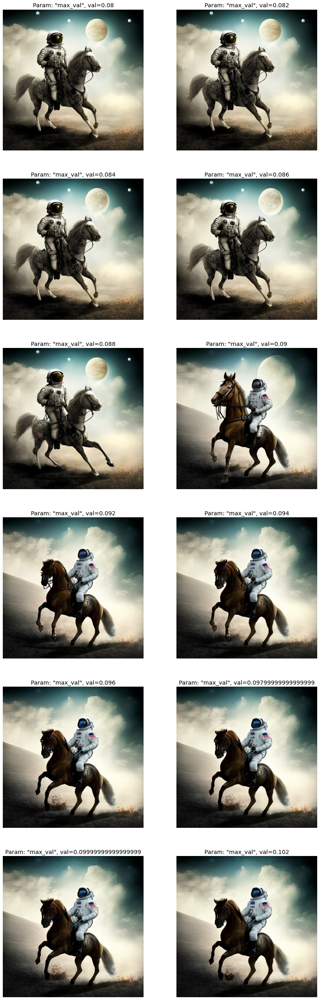

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(full_phase_res['images'], title=full_phase_res['titles'], rows=6, width=width, height=height)

The phase change happens in the same place! In fact the change is more pronounced, there is definitely something strange with the horse's head as we hit the phase transition around $G_\text{small} = 0.09$.

However, it seems that the image grows darker and less clear as we move away from the phase change. The horse's body is less illuminated and is even hard to see.   

One last check, what if the images before the phase change are better? We already saw that 0.05 was a bit too low, but what about values between 0.06 and 0.08? 

# Re-runs to find earlier, potentially better values

In [ ]:
low_bound = 0.06
hi_bound = 0.082
npoints = 11

points = np.linspace(low_bound, hi_bound, npoints+1); points

array([0.06 , 0.062, 0.064, 0.066, 0.068, 0.07 , 0.072, 0.074, 0.076,
       0.078, 0.08 , 0.082])

In [ ]:
# create the constant G_small cosine experiments
early_phase_params = {'max_val': list(points)}
early_phase_func = lambda val: [val for _ in range(num_steps)]
early_phase_expts = create_expts(early_phase_params, early_phase_func)

In [ ]:
print('Running the phase change k-Sweep experiments...')
early_phase_res = run(prompt, early_phase_expts, guide_tfm=TNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.06...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.062...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.064...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.066...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.068...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.07...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.07200000000000001...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.074...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.076...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.078...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.082...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


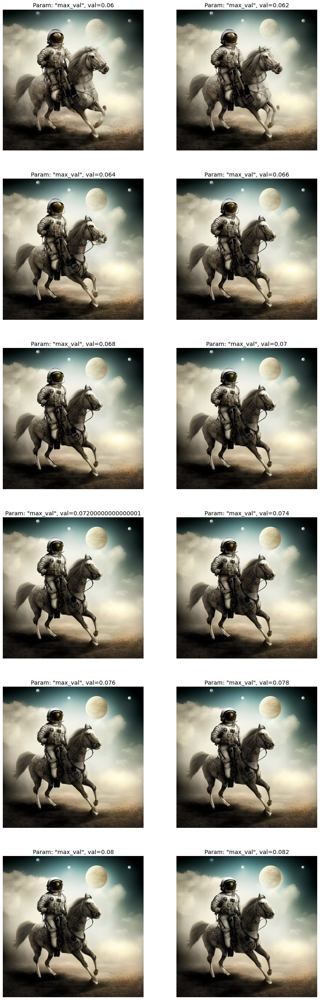

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(early_phase_res['images'], title=early_phase_res['titles'], rows=6, width=width, height=height)

This is a mixed bag. The anatomy of the horse's face is better at lower values, but the rest of the image gains some strange artifacts. For example the horse's leg starts fraying, and the astronaut merges with horse's body. It is safe to say we are in "too small" territory for $G_\text{small}.$

# The final check: $G\ $ from $0.1$ to $0.2$  

There is a noticeable change in the image somewhere between 0.1 and 0.2. Let's do a small sweep in this range to see what happens.

In [ ]:
low_bound = 0.1
hi_bound = 0.202
npoints = 11

points = np.linspace(low_bound, hi_bound, npoints+1); points

array([0.1       , 0.10927273, 0.11854545, 0.12781818, 0.13709091,
       0.14636364, 0.15563636, 0.16490909, 0.17418182, 0.18345455,
       0.19272727, 0.202     ])

In [ ]:
# create the constant G_small cosine experiments
late_phase_params = {'max_val': list(points)}
late_phase_func = lambda val: [val for _ in range(num_steps)]
late_phase_expts = create_expts(late_phase_params, late_phase_func)

In [ ]:
print('Running the phase change k-Sweep experiments...')
late_phase_res = run(prompt, late_phase_expts, guide_tfm=TNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.1...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.10927272727272727...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.11854545454545455...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.12781818181818183...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.1370909090909091...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.14636363636363636...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.15563636363636363...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.16490909090909092...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.1741818181818182...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.18345454545454545...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.19272727272727275...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.202...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


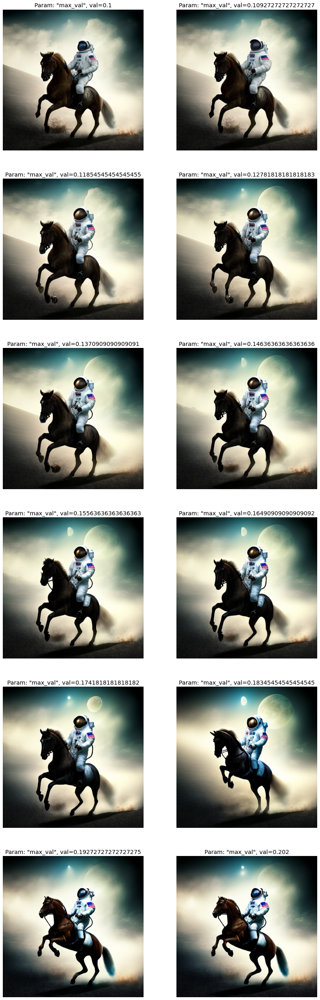

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(late_phase_res['images'], title=late_phase_res['titles'], rows=6, width=width, height=height)

Another phase change! Almost exactly at twice the $G_\text{small}$ from the previous phase change. And, after this second phase change, we re-gain some illumination on the horse's body.  

## Checking for phase change multiples

Will we find another phase change around three times from the first one? Let's find out.  

In [ ]:
low_bound = 0.25
hi_bound = 0.29
npoints = 11

points = np.linspace(low_bound, hi_bound, npoints+1); points

array([0.25      , 0.25363636, 0.25727273, 0.26090909, 0.26454545,
       0.26818182, 0.27181818, 0.27545455, 0.27909091, 0.28272727,
       0.28636364, 0.29      ])

In [ ]:
# create the constant G_small cosine experiments
later_phase_params = {'max_val': list(points)}
later_phase_func = lambda val: [val for _ in range(num_steps)]
later_phase_expts = create_expts(later_phase_params, later_phase_func)

In [ ]:
print('Running the phase change k-Sweep experiments...')
later_phase_res = run(prompt, later_phase_expts, guide_tfm=TNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.25...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.25363636363636366...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.25727272727272726...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.2609090909090909...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.26454545454545453...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.2681818181818182...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.2718181818181818...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.27545454545454545...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.27909090909090906...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.2827272727272727...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.2863636363636364...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.29...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


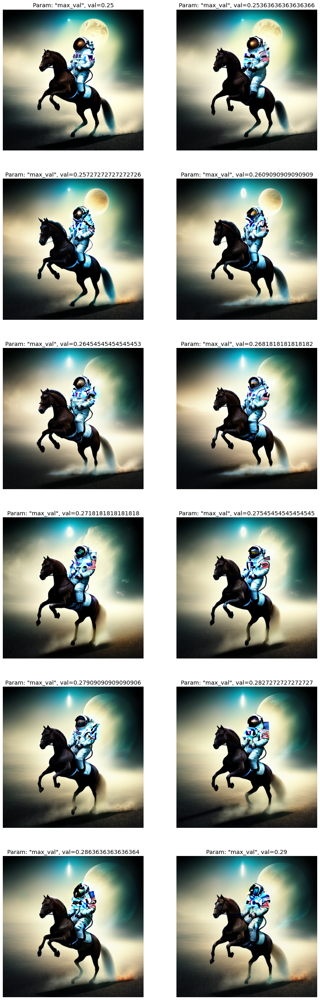

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(later_phase_res['images'], title=later_phase_res['titles'], rows=6, width=width, height=height)

There is no clear phase change, but the image is starting to fall apart. It is safe to say we are in territory where $G_\text{small}$ is too large.  

$G_\text{small} = 0.25$ is the last image where we have a fully correct, non-smeared astronaut.  

# Cosines for the best $G_\text{small}$

We saw that that $G_\text{small}$ should be between 0.08 and 0.25. What happens if we try cosine schedules around these values? 

In [ ]:
def create_cos_expts(params: dict, schedule_func) -> list:
    '''Creates a list of experiments.
    
    Each element is a dictionary with the name, value, and schedule for a given parameter.
    A `title` field is also added for easy plotting.
    '''
    names = sorted(params)
    expts = []
    # step through parameter names and their values
    for i,name in enumerate(names):
        for j,val in enumerate(params[name]):
            # create the experiment
            expt = {'param_name': name,
                    'val': val,
                    'schedule': schedule_func({name: val})}
                    # 'schedule': schedule_func({name: val})}
            # name for plotting
            expt['title'] = f'Param: "{name}", val={val}'
            # add it to the experiment list
            expts.append(expt)
    return expts


Let's sweep a few cosine schedules between the ideal $G_\text{small}$ range.

In [ ]:
low_cos_bound = 0.08
hi_cos_bound = 0.25
npoints = 11
cos_points = np.linspace(low_cos_bound, hi_cos_bound, npoints+1); cos_points

array([0.08      , 0.09545455, 0.11090909, 0.12636364, 0.14181818,
       0.15727273, 0.17272727, 0.18818182, 0.20363636, 0.21909091,
       0.23454545, 0.25      ])

In [ ]:
# create the constant G_small cosine experiments
cos_params = {'max_val': list(cos_points)}
cos_func = partial(cos_harness, default_params=DEFAULT_COS_PARAMS)
cos_expts = create_cos_expts(cos_params, cos_func)

In [ ]:
print('Running the phase change k-Sweep experiments...')
cos_res = run(prompt, cos_expts, guide_tfm=TNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.TNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.09545454545454546...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.1109090909090909...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.12636363636363634...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.14181818181818182...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.1572727272727273...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.17272727272727273...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.18818181818181817...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.20363636363636362...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.21909090909090906...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.23454545454545456...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.25...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


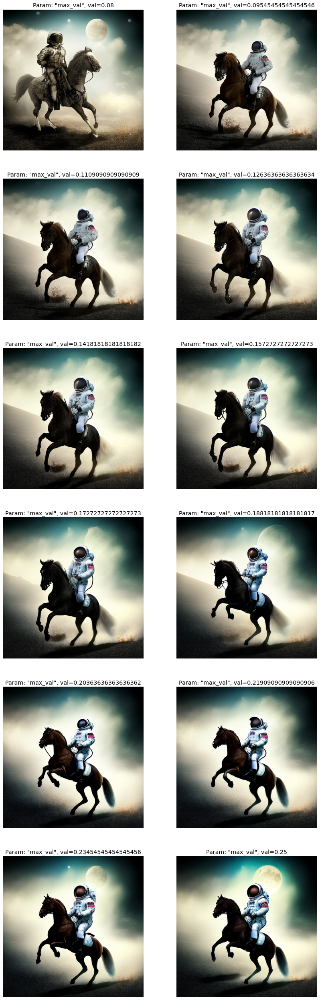

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(cos_res['images'], title=cos_res['titles'], rows=6, width=width, height=height)

For completion, let's try the Cosine sweep on `Full Normalization`

In [ ]:
print('Running the phase change k-Sweep experiments...')
full_norm_cos_res = run(prompt, cos_expts, guide_tfm=FullNormGuidance)

Running the phase change k-Sweep experiments...
Using Guidance Transform: <class 'cf_guidance.transforms.FullNormGuidance'>
Running experiment [1 of 12]: Param: "max_val", val=0.08...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [2 of 12]: Param: "max_val", val=0.09545454545454546...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [3 of 12]: Param: "max_val", val=0.1109090909090909...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [4 of 12]: Param: "max_val", val=0.12636363636363634...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [5 of 12]: Param: "max_val", val=0.14181818181818182...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [6 of 12]: Param: "max_val", val=0.1572727272727273...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [7 of 12]: Param: "max_val", val=0.17272727272727273...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [8 of 12]: Param: "max_val", val=0.18818181818181817...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [9 of 12]: Param: "max_val", val=0.20363636363636362...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [10 of 12]: Param: "max_val", val=0.21909090909090906...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [11 of 12]: Param: "max_val", val=0.23454545454545456...


  0%|          | 0/50 [00:00<?, ?it/s]

Running experiment [12 of 12]: Param: "max_val", val=0.25...


  0%|          | 0/50 [00:00<?, ?it/s]

Done.


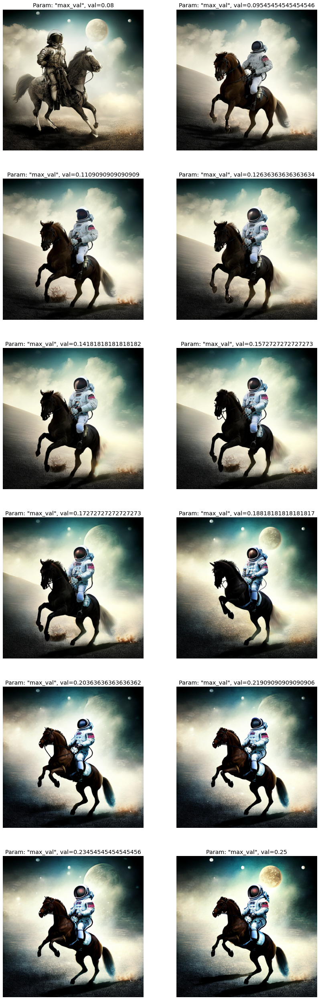

In [ ]:
#| echo: false
#| output: true
# display all images
image_grid(full_norm_cos_res['images'], title=full_norm_cos_res['titles'], rows=6, width=width, height=height)

# Conclusion

This was Part 5 in our series on dynamic Classifier-free Guidance.  

We found a good range of $G_\text{small}$ for both `T` and `Full` Normalizations. We also tried some basic Cosine Schedules around this ideal range.  


In Part 6, we will explore the best schedules for each type of normalization:  
- `Prediction Normalization`  
- `T-Normalization`  
- `Full Normalization`  

Specifically, we will plug in the best `kDecay` Cosine Schedules so far. At that point, we should be able to see a measure and consistent improvement from the original, constant Guidance.  